In [1]:
import numpy as np 
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.pyplot import figure
import matplotlib
import scipy
from scipy.signal import find_peaks, peak_widths
from scipy.signal import argrelextrema, argrelmax, argrelmin


col='grid'
energy='10 MV'
hist="10*full phsp (parallel)"
CSD=1.0
x=np.arange(-2.49,2.49+0.02,0.02)

data=pd.read_csv("Desktop/SFRT-Topas/PVDR_opt/results/dosetomedium_grid_PVDRopt__1.csv",delimiter= ',',comment='#',names=['x','y','z','dose'])
for i in np.arange(2,11):
    data1=pd.read_csv("Desktop/SFRT-Topas/PVDR_opt/results/dosetomedium_grid_PVDRopt__"+str(i)+".csv",delimiter= ',',comment='#',names=['x','y','z','dose'])
    data.dose=data.dose+ data1.dose
data.dose=(data.dose/10)/1021863*0.1e-3/1.60218e-19
    


dose1=np.zeros((250,250))
dose2=np.zeros((250,250))
dose3=np.zeros((250,250))
for i in np.arange(0,len(data.dose),20):
    print(i,data.x)
    dose1[data.x[i]][data.y[i]]=data.dose[i]
    dose2[data.x[i+1]][data.y[i+1]]=data.dose[i+1]
    dose3[data.x[i+2]][data.y[i+2]]=data.dose[i+2]
    







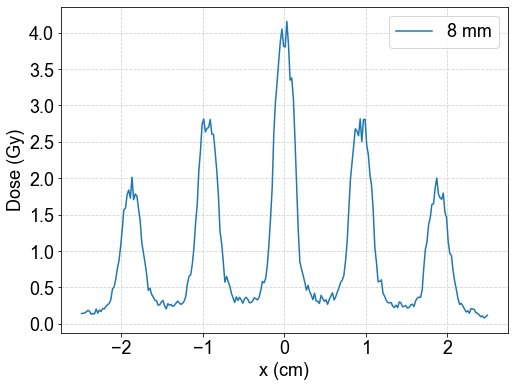

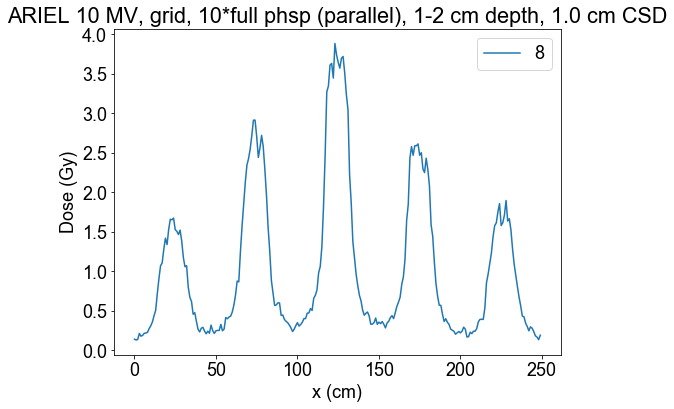

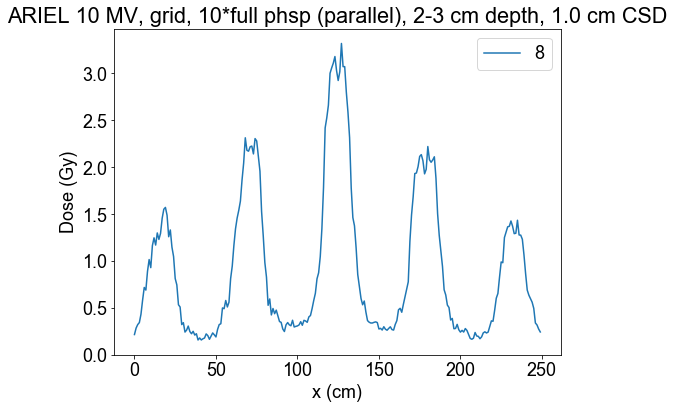

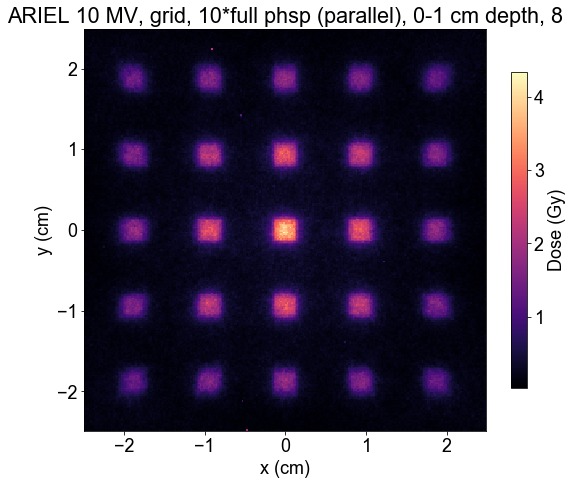

In [4]:
font = {'family' : 'Arial',
        'weight' : 'normal',
        'size'   : 18}

matplotlib.rc('font', **font)

profile1=(dose1.T[125]+dose1.T[124])/2

profile2=(dose2.T[125]+dose2.T[124])/2

profile3=(dose3.T[125]+dose3.T[124])/2

figure(1,figsize=(8,6))
#plt.title('ARIEL '+str(energy)+', '+col+', '+str(hist)+', 0-1 cm depth, '+str(CSD)+' cm CSD')
plt.plot(x,profile1,label='8 mm')
plt.legend()
plt.xlabel('x (cm)')
plt.ylabel('Dose (Gy)')
plt.grid(c='lightgray',ls='--')



figure(2,figsize=(8,6))
plt.title('ARIEL '+str(energy)+', '+col+', '+str(hist)+', 1-2 cm depth, '+str(CSD)+' cm CSD')
plt.plot(profile2,label='8')
plt.legend()
plt.xlabel('x (cm)')
plt.ylabel('Dose (Gy)')

figure(3,figsize=(8,6))
plt.title('ARIEL '+str(energy)+', '+col+', '+str(hist)+', 2-3 cm depth, '+str(CSD)+' cm CSD')
plt.plot(profile3,label='8')
plt.legend()
plt.xlabel('x (cm)')
plt.ylabel('Dose (Gy)')

figure(4,figsize=(9,8))
plt.title('ARIEL '+str(energy)+', '+col+', '+str(hist)+', 0-1 cm depth, 8')
plt.imshow(dose1,cmap='magma',extent=(-2.49,2.49,-2.49,2.49))
plt.xlabel('x (cm)')
plt.ylabel('y (cm)')
plt.colorbar(shrink=0.725,label='Dose (Gy)')





integral = 23225.512561807453
pvdr=8.67
mean peak dose=1.91


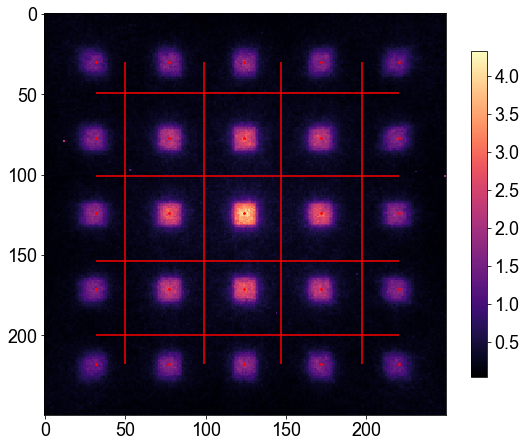

In [13]:
def align_y_axis(ax1, ax2, minresax1, minresax2,numticks):
    """ Sets tick marks of twinx axes to line up with x total tick marks

    ax1 and ax2 are matplotlib axes
    Spacing between tick marks will be a factor of minresax1 and minresax2"""

    ax1ylims = ax1.get_ybound()
    ax2ylims = ax2.get_ybound()
    ax1factor = minresax1 * (numticks-1)
    ax2factor = minresax2 * (numticks-1)
    ax1.set_yticks(np.linspace(ax1ylims[0],
                               ax1ylims[1]+(ax1factor -
                               (ax1ylims[1]-ax1ylims[0]) % ax1factor) %
                               ax1factor,
                               numticks))
    ax2.set_yticks(np.linspace(ax2ylims[0],
                               ax2ylims[1]+(ax2factor -
                               (ax2ylims[1]-ax2ylims[0]) % ax2factor) %
                               ax2factor,
                               numticks))

#integrated dose
print('integral = '+str(sum(sum(dose1))))

#dose_sum=np.array([sum(sum(dose1)),sum(sum(dose1_12)),sum(sum(dose1_22)),sum(sum(dose1_32)),sum(sum(dose1_42)),sum(sum(dose1_52))])


#peaks
mean_peaks=[]
peaks=np.zeros((6,25))
col_avgs=sum(dose1[75:175])
row_avgs=sum(dose1.T[75:175])
peak_rows=find_peaks(row_avgs,distance=25)[0]
peak_cols=find_peaks(col_avgs,distance=25)[0]
peak_cols=peak_cols[int(np.where((peak_cols>=123) & ( peak_cols <=127))[0])-2:int(np.where((peak_cols>=123) & ( peak_cols <=127))[0])+3]
peak_rows=peak_rows[int(np.where((peak_rows>=123) & ( peak_rows <=127))[0])-2:int(np.where((peak_rows>=123) & ( peak_rows <=127))[0])+3]


peaks=[dose1[j][i] for i in peak_rows for j in peak_cols]
mean_peaks=np.mean(peaks)



figure(13,figsize=(9,8))
plt.imshow(dose1.T,cmap='magma')
plt.colorbar(shrink=0.75)
for i in peak_rows:
    for j in peak_cols:
        plt.scatter(j,i,marker='o',c='red',s=3)


    
#valleys
mean_valleys=[]

col_avgs=sum(dose1[75:175])
row_avgs=sum(dose1.T[75:175])
peak_rows=find_peaks(row_avgs,distance=25)[0]
peak_cols=find_peaks(col_avgs,distance=25)[0]
peak_cols=peak_cols[int(np.where((peak_cols>=123) & ( peak_cols <=127))[0])-2:int(np.where((peak_cols>=123) & ( peak_cols <=127))[0])+3]
peak_rows=peak_rows[int(np.where((peak_rows>=123) & ( peak_rows <=127))[0])-2:int(np.where((peak_rows>=123) & ( peak_rows <=127))[0])+3]

valley_rows=find_peaks(row_avgs[peak_rows[0]:peak_rows[-1]]*-1,distance=30)[0]+peak_rows[0]
valley_cols=find_peaks(col_avgs[peak_cols[0]:peak_cols[-1]]*-1,distance=30)[0]+peak_cols[0]

vert_valleys=[]
hori_valleys=[]
    
for i in valley_cols:
    vert_valleys.append(np.mean(dose1.T[i][peak_cols[0]:peak_cols[-1]]))
for i in valley_rows:
    hori_valleys.append(np.mean(dose1[i][peak_rows[0]:peak_rows[-1]]))
              
figure(13,figsize=(9,8))
plt.hlines(valley_rows,peak_cols[0],peak_cols[-1],colors='red')
plt.vlines(valley_cols,peak_rows[0],peak_rows[-1],colors='red')

mean_valleys.append((np.mean(hori_valleys)+np.mean(vert_valleys))/2)

pvdr=mean_peaks/mean_valleys


print('pvdr='+str(round(pvdr[0],2)))
print('mean peak dose rate='+str(round(mean_peaks,2)))


In [3]:
col='grid'
energy='10 MV'
hist="10*full phsp (parallel)"
CSD=1.0
x=np.arange(-2.49,2.49+0.02,0.02)

data=pd.read_csv("D:Desktop/SFRT-Topas/PVDR_opt_5MV/results/dosetomedium_grid_PVDRopt_5MV__1.csv",delimiter= ',',comment='#',names=['x','y','z','dose'])
for i in np.arange(2,11):
    data1=pd.read_csv("D:Desktop/SFRT-Topas/PVDR_opt_5MV/results/dosetomedium_grid_PVDRopt_5MV__"+str(i)+".csv",delimiter= ',',comment='#',names=['x','y','z','dose'])
    data.dose=data.dose+ data1.dose
data.dose=(data.dose/10)/1000000*0.1e-3/1.60218e-19
    


dose1=np.zeros((250,250))
dose2=np.zeros((250,250))
dose3=np.zeros((250,250))
for i in np.arange(0,len(data.dose),20):
    print(i,data.x)
    dose1[data.x[i]][data.y[i]]=data.dose[i]
    dose2[data.x[i+1]][data.y[i+1]]=data.dose[i+1]
    dose3[data.x[i+2]][data.y[i+2]]=data.dose[i+2]
    

0 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
20 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
40 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
60 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
80 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name:

1320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999  

4100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
4120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
4140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
4160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
4180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999  

6860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
6880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
6900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
6920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
6940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999  

9960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
9980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
10000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
10020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
10040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
124999

12780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
12800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
12820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
12840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
12860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

15680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
15700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
15720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
15740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
15760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

19060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
19080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
19100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
19120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
19140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

21880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
21900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
21920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
21940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
21960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

24720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
24740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
24760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
24780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
24800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

27620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
27640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
27660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
27680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
27700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

29480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
29500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
29520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
29540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
29560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

32280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
32300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
32320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
32340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
32360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

35480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
35500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
35520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
35540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
35560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

38420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
38440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
38460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
38480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
38500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

Name: x, Length: 1250000, dtype: int64
41540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
41560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
41580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
41600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
41620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996   

44260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
44280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
44300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
44320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
44340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

Name: x, Length: 1250000, dtype: int64
47280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
47300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
47320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
47340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
47360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996   

50140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
50160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
50180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
50200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
50220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

53520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
53540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
53560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
53580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
53600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

56680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
56700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
56720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
56740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
56760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

59480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
59500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
59520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
59540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
59560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

61960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
61980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
62000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
62020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
62040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

64380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
64400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
64420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
64440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
64460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

65820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
65840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
65860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
65880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
65900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

67560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
67580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
67600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
67620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
67640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

70080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
70100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
70120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
70140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
70160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

72660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
72680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
72700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
72720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
72740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

75800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
75820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
75840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
75860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
75880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

78820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
78840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
78860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
78880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
78900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

81160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
81180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
81200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
81220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
81240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

84520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
84540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
84560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
84580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
84600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

86440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
86460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
86480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
86500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
86520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

89280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
89300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
89320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
89340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
89360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

91580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
91600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
91620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
91640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
91660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

94620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
94640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
94660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
94680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
94700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

Name: x, Length: 1250000, dtype: int64
96560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
96580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
96600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
96620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
96640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996   

99600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
99620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
99640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
99660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
99680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

102860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
102880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
102900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
102920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
102940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

105380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
105400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
105420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
105440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
105460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
108520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
108540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
108560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
108580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
108600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

110920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
110940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
110960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
110980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
111000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
113740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
113760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
113780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
113800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
113820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

116360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
116380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
116400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
116420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
116440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

118500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
118520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
118540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
118560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
118580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

121640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
121660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
121680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
121700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
121720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
124120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
124140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
124160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
124180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
124200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

126440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
126460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
126480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
126500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
126520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
128800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
128820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
128840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
128860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
128880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

Name: x, Length: 1250000, dtype: int64
131080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
131100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
131120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
131140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
131160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

133740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
133760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
133780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
133800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
133820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

136680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
136700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
136720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
136740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
136760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
139080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
139100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
139120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
139140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
139160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

141080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
141100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
141120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
141140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
141160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
142980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
143000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
143020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
143040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
143060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

Name: x, Length: 1250000, dtype: int64
144860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
144880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
144900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
144920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
144940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

Name: x, Length: 1250000, dtype: int64
146880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
146900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
146920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
146940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
146960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

149100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
149120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
149140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
149160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
149180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

150880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
150900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
150920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
150940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
150960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

153560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
153580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
153600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
153620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
153640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

155600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
155620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
155640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
155660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
155680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

157680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
157700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
157720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
157740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
157760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

160580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
160600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
160620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
160640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
160660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

162260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
162280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
162300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
162320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
162340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

164440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
164460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
164480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
164500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
164520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

166960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
166980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
167000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
167020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
167040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
169660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
169680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
169700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
169720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
169740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

Name: x, Length: 1250000, dtype: int64
172360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
172380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
172400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
172420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
172440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

174940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
174960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
174980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
175000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
175020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
177540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
177560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
177580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
177600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
177620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

180320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
180340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
180360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
180380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
180400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

183200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
183220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
183240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
183260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
183280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

186920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
186940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
186960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
186980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
187000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

189900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
189920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
189940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
189960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
189980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

192700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
192720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
192740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
192760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
192780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

195460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
195480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
195500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
195520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
195540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

198580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
198600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
198620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
198640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
198660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

201680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
201700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
201720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
201740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
201760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

204660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
204680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
204700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
204720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
204740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

207260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
207280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
207300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
207320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
207340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
209820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
209840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
209860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
209880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
209900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

213360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
213380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
213400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
213420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
213440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

217780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
217800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
217820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
217840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
217860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

221140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
221160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
221180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
221200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
221220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

224300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
224320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
224340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
224360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
224380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

227000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
227020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
227040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
227060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
227080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

230060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
230080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
230100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
230120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
230140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

233360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
233380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
233400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
233420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
233440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
236020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
236040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
236060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
236080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
236100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

238700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
238720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
238740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
238760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
238780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

241160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
241180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
241200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
241220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
241240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
242780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
242800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
242820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
242840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
242860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

245780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
245800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
245820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
245840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
245860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

248860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
248880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
248900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
248920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
248940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

250720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
250740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
250760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
250780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
250800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

253420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
253440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
253460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
253480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
253500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
256620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
256640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
256660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
256680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
256700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

Name: x, Length: 1250000, dtype: int64
258920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
258940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
258960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
258980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
259000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

Name: x, Length: 1250000, dtype: int64
262160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
262180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
262200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
262220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
262240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

264420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
264440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
264460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
264480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
264500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

267440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
267460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
267480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
267500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
267520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

270100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
270120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
270140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
270160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
270180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

272580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
272600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
272620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
272640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
272660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

274680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
274700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
274720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
274740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
274760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

276640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
276660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
276680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
276700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
276720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
279200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
279220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
279240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
279260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
279280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

Name: x, Length: 1250000, dtype: int64
282440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
282460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
282480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
282500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
282520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

285680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
285700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
285720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
285740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
285760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

288140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
288160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
288180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
288200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
288220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
290740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
290760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
290780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
290800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
290820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

293540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
293560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
293580

KeyboardInterrupt: 

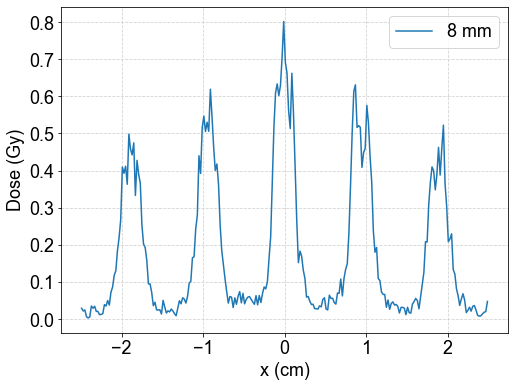

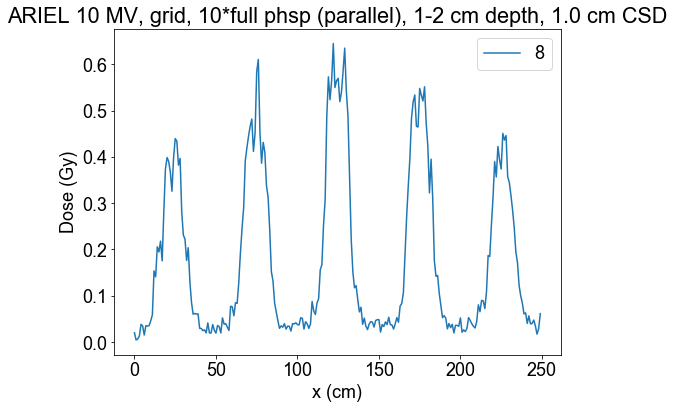

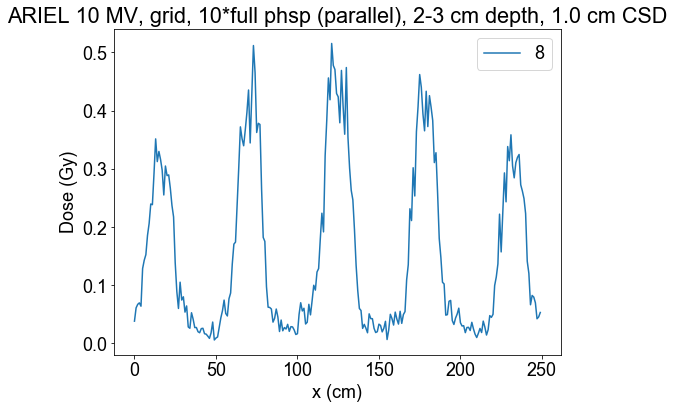

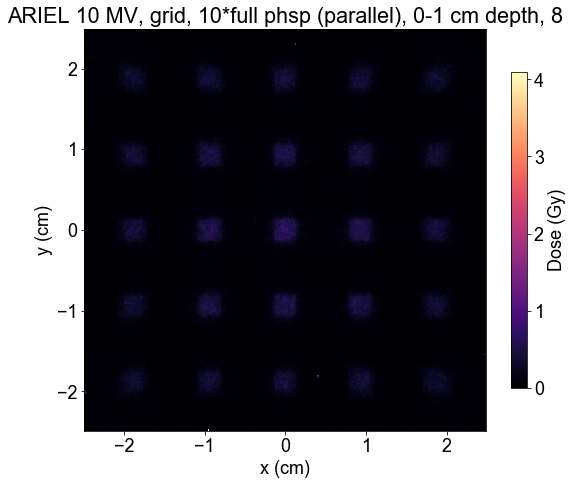

In [17]:
font = {'family' : 'Arial',
        'weight' : 'normal',
        'size'   : 18}

matplotlib.rc('font', **font)

profile1=(dose1.T[125]+dose1.T[124])/2

profile2=(dose2.T[125]+dose2.T[124])/2

profile3=(dose3.T[125]+dose3.T[124])/2

figure(1,figsize=(8,6))
#plt.title('ARIEL '+str(energy)+', '+col+', '+str(hist)+', 0-1 cm depth, '+str(CSD)+' cm CSD')
plt.plot(x,profile1,label='8 mm')
plt.legend()
plt.xlabel('x (cm)')
plt.ylabel('Dose (Gy)')
plt.grid(c='lightgray',ls='--')



figure(2,figsize=(8,6))
plt.title('ARIEL '+str(energy)+', '+col+', '+str(hist)+', 1-2 cm depth, '+str(CSD)+' cm CSD')
plt.plot(profile2,label='8')
plt.legend()
plt.xlabel('x (cm)')
plt.ylabel('Dose (Gy)')

figure(3,figsize=(8,6))
plt.title('ARIEL '+str(energy)+', '+col+', '+str(hist)+', 2-3 cm depth, '+str(CSD)+' cm CSD')
plt.plot(profile3,label='8')
plt.legend()
plt.xlabel('x (cm)')
plt.ylabel('Dose (Gy)')

figure(4,figsize=(9,8))
plt.title('ARIEL '+str(energy)+', '+col+', '+str(hist)+', 0-1 cm depth, 8')
plt.imshow(dose1,cmap='magma',extent=(-2.49,2.49,-2.49,2.49))
plt.xlabel('x (cm)')
plt.ylabel('y (cm)')
plt.colorbar(shrink=0.725,label='Dose (Gy)')



integral = 4302.291894423255
pvdr=15.87
mean peak dose rate=0.45 Gy/s


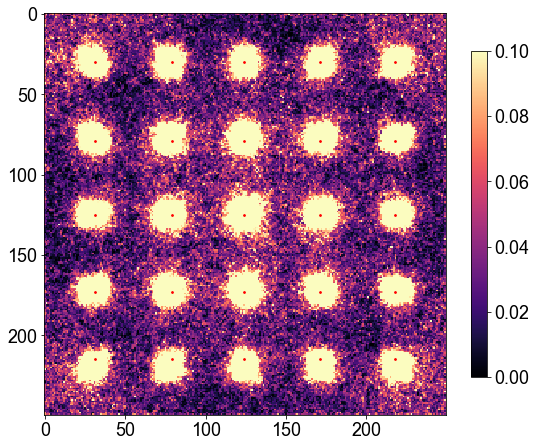

In [20]:
def align_y_axis(ax1, ax2, minresax1, minresax2,numticks):
    """ Sets tick marks of twinx axes to line up with x total tick marks

    ax1 and ax2 are matplotlib axes
    Spacing between tick marks will be a factor of minresax1 and minresax2"""

    ax1ylims = ax1.get_ybound()
    ax2ylims = ax2.get_ybound()
    ax1factor = minresax1 * (numticks-1)
    ax2factor = minresax2 * (numticks-1)
    ax1.set_yticks(np.linspace(ax1ylims[0],
                               ax1ylims[1]+(ax1factor -
                               (ax1ylims[1]-ax1ylims[0]) % ax1factor) %
                               ax1factor,
                               numticks))
    ax2.set_yticks(np.linspace(ax2ylims[0],
                               ax2ylims[1]+(ax2factor -
                               (ax2ylims[1]-ax2ylims[0]) % ax2factor) %
                               ax2factor,
                               numticks))

#integrated dose
print('integral = '+str(sum(sum(dose1))))

#dose_sum=np.array([sum(sum(dose1)),sum(sum(dose1_12)),sum(sum(dose1_22)),sum(sum(dose1_32)),sum(sum(dose1_42)),sum(sum(dose1_52))])


#peaks
mean_peaks=[]
peaks=np.zeros((6,25))
col_avgs=sum(dose1[75:175])
row_avgs=sum(dose1.T[75:175])
peak_rows=find_peaks(row_avgs,distance=25)[0]
peak_cols=find_peaks(col_avgs,distance=25)[0]
peak_cols=peak_cols[int(np.where((peak_cols>=123) & ( peak_cols <=127))[0])-2:int(np.where((peak_cols>=123) & ( peak_cols <=127))[0])+3]
peak_rows=peak_rows[int(np.where((peak_rows>=123) & ( peak_rows <=127))[0])-2:int(np.where((peak_rows>=123) & ( peak_rows <=127))[0])+3]


peaks=[dose1[j][i] for i in peak_rows for j in peak_cols]
mean_peaks=np.mean(peaks)



figure(13,figsize=(9,8))
plt.imshow(dose1.T,cmap='magma',vmax=0.1)
plt.colorbar(shrink=0.75)
for i in peak_rows:
    for j in peak_cols:
        plt.scatter(j,i,marker='o',c='red',s=3)


    
#valleys
mean_valleys=[]

col_avgs=sum(dose1[75:175])
row_avgs=sum(dose1.T[75:175])
peak_rows=find_peaks(row_avgs,distance=25)[0]
peak_cols=find_peaks(col_avgs,distance=25)[0]
peak_cols=peak_cols[int(np.where((peak_cols>=123) & ( peak_cols <=127))[0])-2:int(np.where((peak_cols>=123) & ( peak_cols <=127))[0])+3]
peak_rows=peak_rows[int(np.where((peak_rows>=123) & ( peak_rows <=127))[0])-2:int(np.where((peak_rows>=123) & ( peak_rows <=127))[0])+3]

valley_rows=find_peaks(row_avgs[peak_rows[0]:peak_rows[-1]]*-1,distance=30)[0]+peak_rows[0]
valley_cols=find_peaks(col_avgs[peak_cols[0]:peak_cols[-1]]*-1,distance=30)[0]+peak_cols[0]

vert_valleys=[]
hori_valleys=[]
    
for i in valley_cols:
    vert_valleys.append(np.mean(dose1.T[i][peak_cols[0]:peak_cols[-1]]))
for i in valley_rows:
    hori_valleys.append(np.mean(dose1[i][peak_rows[0]:peak_rows[-1]]))
              
figure(13,figsize=(9,8))
#plt.hlines(valley_rows,peak_cols[0],peak_cols[-1],colors='red')
#plt.vlines(valley_cols,peak_rows[0],peak_rows[-1],colors='red')

mean_valleys.append((np.mean(hori_valleys)+np.mean(vert_valleys))/2)

pvdr=mean_peaks/mean_valleys


print('pvdr='+str(round(pvdr[0],2)))
print('mean peak dose rate='+str(round(mean_peaks,2))+' Gy/s')

In [7]:
col='grid'
energy='10 MV'
hist="10*full phsp (parallel)"
CSD=1.0
x=np.arange(-2.49,2.49+0.02,0.02)

data=pd.read_csv("D:Desktop/SFRT-Topas/PVDR_opt_1MV/results/dosetomedium_grid_PVDRopt_1MV__1.csv",delimiter= ',',comment='#',names=['x','y','z','dose'])
for i in np.arange(2,51):
    data1=pd.read_csv("D:Desktop/SFRT-Topas/PVDR_opt_1MV/results/dosetomedium_grid_PVDRopt_1MV__"+str(i)+".csv",delimiter= ',',comment='#',names=['x','y','z','dose'])
    data.dose=data.dose+ data1.dose
data.dose=(data.dose/50)/10000000*0.1e-3/1.60218e-19
    


dose1=np.zeros((250,250))
dose2=np.zeros((250,250))
dose3=np.zeros((250,250))
for i in np.arange(0,len(data.dose),20):
    print(i,data.x)
    dose1[data.x[i]][data.y[i]]=data.dose[i]
    dose2[data.x[i+1]][data.y[i+1]]=data.dose[i+1]
    dose3[data.x[i+2]][data.y[i+2]]=data.dose[i+2]
    

0 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
20 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
40 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
60 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
80 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name:

1740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999  

4440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
4460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
4480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
4500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
4520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999  

7400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
7420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
7440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
7460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
7480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999  

10480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
10500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
10520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
10540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
10560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

13740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
13760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
13780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
13800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
13820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

16740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
16760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
16780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
16800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
16820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

19480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
19500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
19520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
19540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
19560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

22920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
22940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
22960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
22980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
23000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

25900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
25920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
25940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
25960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
25980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

Name: x, Length: 1250000, dtype: int64
28620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
28640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
28660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
28680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
28700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996   

32280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
32300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
32320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
32340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
32360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

34840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
34860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
34880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
34900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
34920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

38020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
38040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
38060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
38080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
38100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

Name: x, Length: 1250000, dtype: int64
41220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
41240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
41260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
41280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
41300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996   

44420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
44440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
44460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
44480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
44500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

47120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
47140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
47160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
47180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
47200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

50260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
50280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
50300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
50320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
50340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

53480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
53500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
53520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
53540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
53560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

56640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
56660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
56680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
56700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
56720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

59340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
59360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
59380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
59400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
59420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

62320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
62340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
62360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
62380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
62400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

66500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
66520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
66540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
66560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
66580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

Name: x, Length: 1250000, dtype: int64
69880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
69900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
69920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
69940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
69960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996   

71960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
71980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
72000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
72020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
72040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

Name: x, Length: 1250000, dtype: int64
75020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
75040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
75060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
75080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
75100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996   

77060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
77080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
77100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
77120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
77140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

80800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
80820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
80840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
80860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
80880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

83980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
84000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
84020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
84040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
84060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

87220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
87240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
87260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
87280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
87300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

90160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
90180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
90200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
90220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
90240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

92860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
92880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
92900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
92920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
92940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

95480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
95500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
95520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
95540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
95560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

98260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
98280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
98300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
98320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
98340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249

101440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
101460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
101480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
101500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
101520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

104520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
104540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
104560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
104580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
104600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

107860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
107880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
107900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
107920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
107940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

110560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
110580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
110600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
110620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
110640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

113420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
113440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
113460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
113480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
113500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

116460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
116480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
116500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
116520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
116540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

119800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
119820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
119840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
119860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
119880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

122780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
122800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
122820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
122840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
122860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

126020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
126040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
126060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
126080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
126100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

129060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
129080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
129100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
129120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
129140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

132120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
132140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
132160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
132180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
132200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

135780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
135800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
135820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
135840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
135860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

138180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
138200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
138220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
138240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
138260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

141400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
141420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
141440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
141460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
141480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

144200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
144220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
144240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
144260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
144280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

147080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
147100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
147120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
147140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
147160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

150020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
150040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
150060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
150080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
150100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

152760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
152780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
152800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
152820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
152840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

155500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
155520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
155540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
155560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
155580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

158320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
158340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
158360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
158380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
158400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

161500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
161520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
161540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
161560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
161580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

164580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
164600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
164620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
164640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
164660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

167680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
167700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
167720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
167740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
167760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

170080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
170100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
170120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
170140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
170160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

172760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
172780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
172800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
172820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
172840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

175780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
175800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
175820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
175840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
175860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

178800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
178820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
178840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
178860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
178880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

181460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
181480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
181500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
181520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
181540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

184980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
185000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
185020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
185040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
185060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

188620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
188640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
188660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
188680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
188700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

192320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
192340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
192360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
192380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
192400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

196280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
196300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
196320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
196340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
196360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

199120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
199140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
199160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
199180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
199200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

202060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
202080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
202100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
202120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
202140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

205240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
205260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
205280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
205300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
205320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

207900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
207920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
207940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
207960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
207980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

210400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
210420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
210440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
210460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
210480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

214820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
214840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
214860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
214880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
214900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

217160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
217180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
217200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
217220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
217240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

219900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
219920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
219940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
219960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
219980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

223020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
223040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
223060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
223080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
223100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

226360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
226380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
226400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
226420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
226440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

229260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
229280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
229300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
229320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
229340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

231700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
231720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
231740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
231760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
231780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

234840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
234860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
234880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
234900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
234920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

237540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
237560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
237580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
237600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
237620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

241100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
241120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
241140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
241160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
241180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

243940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
243960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
243980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
244000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
244020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

247160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
247180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
247200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
247220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
247240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

249980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
250000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
250020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
250040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
250060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

253160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
253180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
253200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
253220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
253240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

256680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
256700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
256720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
256740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
256760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

259900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
259920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
259940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
259960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
259980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

262620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
262640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
262660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
262680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
262700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

265740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
265760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
265780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
265800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
265820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

268820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
268840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
268860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
268880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
268900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

271320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
271340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
271360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
271380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
271400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

274980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
275000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
275020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
275040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
275060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

277840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
277860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
277880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
277900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
277920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

280760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
280780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
280800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
280820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
280840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

283460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
283480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
283500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
283520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
283540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

286940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
286960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
286980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
287000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
287020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

289920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
289940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
289960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
289980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
290000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

293480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
293500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
293520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
293540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
293560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

295920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
295940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
295960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
295980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
296000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
299460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
299480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
299500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
299520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
299540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

301140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
301160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
301180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
301200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
301220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

304220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
304240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
304260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
304280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
304300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

306540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
306560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
306580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
306600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
306620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

310080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
310100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
310120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
310140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
310160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

312820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
312840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
312860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
312880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
312900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

316500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
316520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
316540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
316560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
316580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

319620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
319640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
319660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
319680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
319700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

322420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
322440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
322460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
322480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
322500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

325840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
325860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
325880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
325900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
325920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

328960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
328980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
329000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
329020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
329040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

331660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
331680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
331700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
331720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
331740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
334520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
334540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
334560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
334580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
334600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

337200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
337220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
337240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
337260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
337280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

340340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
340360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
340380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
340400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
340420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

342960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
342980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
343000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
343020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
343040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

346040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
346060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
346080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
346100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
346120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

348840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
348860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
348880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
348900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
348920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

352080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
352100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
352120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
352140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
352160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
355380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
355400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
355420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
355440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
355460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

358700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
358720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
358740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
358760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
358780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

361300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
361320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
361340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
361360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
361380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

364420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
364440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
364460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
364480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
364500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

367400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
367420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
367440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
367460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
367480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

370440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
370460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
370480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
370500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
370520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

374100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
374120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
374140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
374160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
374180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

377640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
377660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
377680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
377700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
377720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

380220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
380240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
380260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
380280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
380300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

383140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
383160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
383180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
383200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
383220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

386280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
386300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
386320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
386340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
386360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

389440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
389460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
389480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
389500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
389520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

392000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
392020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
392040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
392060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
392080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

395120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
395140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
395160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
395180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
395200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

397740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
397760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
397780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
397800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
397820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

400700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
400720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
400740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
400760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
400780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

404520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
404540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
404560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
404580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
404600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

407120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
407140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
407160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
407180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
407200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

411440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
411460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
411480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
411500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
411520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

414720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
414740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
414760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
414780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
414800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

417940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
417960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
417980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
418000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
418020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

421540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
421560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
421580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
421600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
421620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

424480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
424500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
424520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
424540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
424560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

426080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
426100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
426120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
426140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
426160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

429300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
429320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
429340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
429360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
429380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

431860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
431880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
431900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
431920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
431940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

435500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
435520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
435540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
435560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
435580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
437940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
437960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
437980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
438000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
438020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

440040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
440060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
440080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
440100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
440120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

443380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
443400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
443420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
443440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
443460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

445880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
445900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
445920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
445940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
445960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
448520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
448540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
448560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
448580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
448600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

451740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
451760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
451780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
451800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
451820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
455340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
455360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
455380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
455400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
455420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

457940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
457960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
457980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
458000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
458020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

461460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
461480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
461500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
461520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
461540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
464580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
464600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
464620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
464640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
464660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

467200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
467220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
467240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
467260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
467280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

470080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
470100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
470120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
470140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
470160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

473580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
473600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
473620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
473640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
473660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

476340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
476360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
476380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
476400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
476420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
479720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
479740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
479760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
479780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
479800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

482700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
482720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
482740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
482760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
482780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

485460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
485480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
485500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
485520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
485540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

489020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
489040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
489060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
489080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
489100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

491980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
492000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
492020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
492040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
492060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

495560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
495580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
495600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
495620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
495640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

499700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
499720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
499740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
499760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
499780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

503040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
503060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
503080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
503100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
503120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

506780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
506800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
506820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
506840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
506860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

509880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
509900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
509920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
509940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
509960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

512820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
512840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
512860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
512880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
512900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

516380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
516400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
516420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
516440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
516460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

519660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
519680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
519700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
519720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
519740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

523280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
523300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
523320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
523340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
523360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

526100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
526120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
526140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
526160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
526180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
528980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
529000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
529020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
529040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
529060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

531780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
531800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
531820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
531840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
531860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

534580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
534600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
534620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
534640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
534660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

538040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
538060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
538080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
538100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
538120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

542240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
542260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
542280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
542300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
542320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

544780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
544800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
544820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
544840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
544860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

547200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
547220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
547240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
547260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
547280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

549940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
549960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
549980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
550000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
550020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

552520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
552540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
552560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
552580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
552600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

554580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
554600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
554620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
554640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
554660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

557600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
557620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
557640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
557660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
557680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

560700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
560720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
560740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
560760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
560780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
563960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
563980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
564000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
564020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
564040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

567040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
567060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
567080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
567100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
567120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

569620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
569640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
569660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
569680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
569700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

573080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
573100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
573120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
573140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
573160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

576340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
576360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
576380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
576400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
576420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

579100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
579120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
579140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
579160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
579180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

581900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
581920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
581940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
581960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
581980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

585200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
585220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
585240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
585260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
585280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

588500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
588520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
588540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
588560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
588580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

591040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
591060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
591080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
591100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
591120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

594780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
594800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
594820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
594840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
594860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
598040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
598060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
598080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
598100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
598120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

601100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
601120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
601140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
601160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
601180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

604020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
604040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
604060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
604080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
604100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
606860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
606880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
606900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
606920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
606940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

609920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
609940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
609960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
609980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
610000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

613380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
613400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
613420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
613440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
613460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

616480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
616500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
616520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
616540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
616560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

619620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
619640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
619660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
619680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
619700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

623380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
623400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
623420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
623440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
623460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

626340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
626360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
626380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
626400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
626420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
629680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
629700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
629720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
629740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
629760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

632620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
632640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
632660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
632680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
632700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

635100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
635120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
635140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
635160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
635180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
638640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
638660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
638680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
638700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
638720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

Name: x, Length: 1250000, dtype: int64
641620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
641640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
641660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
641680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
641700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

644620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
644640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
644660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
644680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
644700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

647280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
647300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
647320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
647340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
647360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

650740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
650760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
650780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
650800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
650820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

654180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
654200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
654220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
654240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
654260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

656600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
656620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
656640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
656660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
656680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

660620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
660640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
660660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
660680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
660700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

663980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
664000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
664020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
664040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
664060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

668120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
668140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
668160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
668180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
668200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

671360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
671380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
671400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
671420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
671440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

674140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
674160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
674180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
674200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
674220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

678280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
678300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
678320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
678340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
678360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

680960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
680980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
681000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
681020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
681040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

684060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
684080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
684100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
684120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
684140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

687060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
687080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
687100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
687120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
687140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

690440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
690460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
690480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
690500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
690520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

693640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
693660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
693680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
693700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
693720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

697080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
697100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
697120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
697140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
697160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

699940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
699960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
699980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
700000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
700020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

703360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
703380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
703400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
703420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
703440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

706960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
706980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
707000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
707020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
707040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

710680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
710700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
710720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
710740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
710760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

714080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
714100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
714120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
714140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
714160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

717260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
717280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
717300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
717320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
717340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

720800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
720820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
720840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
720860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
720880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

723600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
723620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
723640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
723660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
723680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

726140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
726160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
726180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
726200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
726220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
729020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
729040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
729060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
729080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
729100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

732680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
732700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
732720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
732740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
732760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

735860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
735880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
735900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
735920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
735940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

739040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
739060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
739080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
739100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
739120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
741700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
741720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
741740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
741760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
741780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

Name: x, Length: 1250000, dtype: int64
744300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
744320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
744340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
744360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
744380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

746480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
746500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
746520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
746540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
746560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

749980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
750000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
750020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
750040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
750060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

754000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
754020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
754040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
754060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
754080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
756060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
756080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
756100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
756120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
756140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

759500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
759520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
759540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
759560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
759580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

762280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
762300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
762320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
762340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
762360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

765860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
765880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
765900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
765920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
765940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

769140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
769160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
769180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
769200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
769220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

771860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
771880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
771900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
771920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
771940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

775240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
775260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
775280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
775300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
775320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

778920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
778940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
778960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
778980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
779000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

782360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
782380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
782400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
782420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
782440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

785800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
785820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
785840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
785860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
785880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

789420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
789440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
789460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
789480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
789500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

792360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
792380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
792400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
792420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
792440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

795860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
795880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
795900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
795920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
795940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

800400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
800420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
800440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
800460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
800480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

803360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
803380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
803400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
803420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
803440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

806500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
806520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
806540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
806560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
806580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

810120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
810140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
810160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
810180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
810200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

813340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
813360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
813380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
813400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
813420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

816280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
816300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
816320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
816340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
816360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

820040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
820060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
820080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
820100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
820120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

823320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
823340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
823360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
823380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
823400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

825900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
825920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
825940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
825960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
825980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

829140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
829160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
829180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
829200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
829220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

832240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
832260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
832280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
832300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
832320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

835700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
835720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
835740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
835760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
835780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

838800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
838820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
838840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
838860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
838880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

841740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
841760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
841780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
841800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
841820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

845440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
845460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
845480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
845500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
845520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

848440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
848460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
848480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
848500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
848520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

850180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
850200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
850220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
850240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
850260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

852480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
852500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
852520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
852540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
852560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

856460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
856480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
856500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
856520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
856540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

859440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
859460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
859480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
859500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
859520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

861980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
862000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
862020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
862040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
862060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

864720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
864740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
864760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
864780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
864800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

868240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
868260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
868280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
868300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
868320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

871140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
871160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
871180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
871200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
871220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

874580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
874600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
874620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
874640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
874660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

877820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
877840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
877860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
877880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
877900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
880480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
880500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
880520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
880540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
880560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

883640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
883660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
883680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
883700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
883720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

886120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
886140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
886160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
886180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
886200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

889320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
889340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
889360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
889380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
889400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

891940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
891960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
891980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
892000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
892020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

895780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
895800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
895820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
895840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
895860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

898900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
898920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
898940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
898960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
898980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

903340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
903360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
903380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
903400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
903420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

906640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
906660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
906680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
906700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
906720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

909920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
909940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
909960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
909980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
910000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

913020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
913040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
913060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
913080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
913100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

916060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
916080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
916100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
916120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
916140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

919240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
919260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
919280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
919300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
919320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

922600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
922620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
922640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
922660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
922680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

925340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
925360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
925380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
925400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
925420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

928320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
928340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
928360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
928380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
928400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

931420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
931440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
931460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
931480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
931500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

934200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
934220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
934240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
934260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
934280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

936720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
936740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
936760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
936780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
936800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

939560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
939580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
939600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
939620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
939640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

942540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
942560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
942580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
942600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
942620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

945080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
945100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
945120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
945140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
945160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

947860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
947880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
947900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
947920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
947940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

950400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
950420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
950440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
950460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
950480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

954740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
954760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
954780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
954800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
954820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

957460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
957480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
957500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
957520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
957540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

960840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
960860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
960880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
960900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
960920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

963620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
963640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
963660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
963680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
963700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

966920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
966940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
966960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
966980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
967000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

969980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
970000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
970020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
970040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
970060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

972720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
972740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
972760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
972780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
972800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

975880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
975900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
975920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
975940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
975960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

979140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
979160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
979180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
979200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
979220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

981820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
981840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
981860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
981880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
981900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

984760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
984780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
984800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
984820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
984840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

987460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
987480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
987500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
987520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
987540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

990180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
990200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
990220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
990240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
990260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

992940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
992960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
992980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
993000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
993020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249

Name: x, Length: 1250000, dtype: int64
996740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
996760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
996780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
996800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
996820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
12499

1000360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1000380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1000400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1000420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1000440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1003540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1003560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1003580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1003600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1003620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1005920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1005940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1005960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1005980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1006000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

Name: x, Length: 1250000, dtype: int64
1008760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1008780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1008800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1008820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1008840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249


Name: x, Length: 1250000, dtype: int64
1011760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1011780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1011800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1011820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1011840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249


1014820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1014840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1014860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1014880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1014900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1018120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1018140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1018160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1018180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1018200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1020900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1020920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1020940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1020960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1020980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1024460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1024480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1024500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1024520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1024540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1027160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1027180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1027200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1027220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1027240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1030160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1030180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1030200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1030220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1030240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1033240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1033260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1033280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1033300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1033320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1036200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1036220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1036240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1036260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1036280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1039780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1039800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1039820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1039840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1039860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1043160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1043180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1043200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1043220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1043240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1046380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1046400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1046420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1046440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1046460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

Name: x, Length: 1250000, dtype: int64
1048700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1048720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1048740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1048760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1048780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249


1052540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1052560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1052580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1052600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1052620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1055460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1055480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1055500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1055520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1055540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1058720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1058740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1058760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1058780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1058800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1061920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1061940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1061960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1061980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1062000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1064120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1064140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1064160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1064180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1064200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1066820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1066840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1066860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1066880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1066900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1069840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1069860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1069880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1069900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1069920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1073820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1073840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1073860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1073880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1073900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1076940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1076960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1076980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1077000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1077020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1079980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1080000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1080020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1080040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1080060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1082340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1082360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1082380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1082400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1082420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1085240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1085260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1085280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1085300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1085320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1087880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1087900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1087920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1087940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1087960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1091120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1091140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1091160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1091180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1091200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1093640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1093660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1093680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1093700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1093720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1097060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1097080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1097100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1097120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1097140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1099720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1099740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1099760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1099780 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1099800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1102280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1102300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1102320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1102340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1102360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1105240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1105260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1105280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1105300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1105320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

Name: x, Length: 1250000, dtype: int64
1109040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1109060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1109080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1109100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1109120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249


1112680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1112700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1112720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1112740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1112760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1115940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1115960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1115980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1116000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1116020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1119100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1119120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1119140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1119160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1119180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1122120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1122140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1122160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1122180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1122200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1124320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1124340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1124360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1124380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1124400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1126880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1126900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1126920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1126940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1126960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1130360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1130380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1130400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1130420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1130440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1133380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1133400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1133420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1133440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1133460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1135400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1135420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1135440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1135460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1135480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1138080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1138100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1138120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1138140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1138160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1140580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1140600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1140620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1140640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1140660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1143140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1143160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1143180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1143200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1143220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1146400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1146420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1146440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1146460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1146480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1149620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1149640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1149660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1149680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1149700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1152220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1152240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1152260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1152280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1152300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

Name: x, Length: 1250000, dtype: int64
1154440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1154460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1154480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1154500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1154520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249


1156680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1156700 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1156720 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1156740 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1156760 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1159860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1159880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1159900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1159920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1159940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1162600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1162620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1162640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1162660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1162680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

Name: x, Length: 1250000, dtype: int64
1165460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1165480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1165500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1165520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1165540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249


1169960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1169980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1170000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1170020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1170040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

Name: x, Length: 1250000, dtype: int64
1172440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1172460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1172480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1172500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1172520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249


1175480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1175500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1175520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1175540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1175560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1178320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1178340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1178360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1178380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1178400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1181440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1181460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1181480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1181500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1181520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1184060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1184080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1184100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1184120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1184140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1187180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1187200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1187220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1187240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1187260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1189480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1189500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1189520 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1189540 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1189560 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1192280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1192300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1192320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1192340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1192360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1195060 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1195080 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1195100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1195120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1195140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

Name: x, Length: 1250000, dtype: int64
1198280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1198300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1198320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1198340 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1198360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249


1200240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1200260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1200280 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1200300 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1200320 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1203420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1203440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1203460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1203480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1203500 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1206600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1206620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1206640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1206660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1206680 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1209580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1209600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1209620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1209640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1209660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1212800 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1212820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1212840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1212860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1212880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1214960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1214980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1215000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1215020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1215040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1219100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1219120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1219140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1219160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1219180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1221360 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1221380 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1221400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1221420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1221440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1224100 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1224120 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1224140 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1224160 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1224180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1226940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1226960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1226980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1227000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1227020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1229580 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1229600 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1229620 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1229640 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1229660 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1232400 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1232420 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1232440 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1232460 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1232480 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1235920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1235940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1235960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1235980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1236000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1238960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1238980 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1239000 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1239020 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1239040 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1243180 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1243200 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1243220 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1243240 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1243260 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

1244820 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1244840 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1244860 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1244880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1244900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998  

Name: x, Length: 1250000, dtype: int64
1247880 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1247900 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1247920 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1247940 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249
1249996    249
1249997    249
1249998    249
1249999    249
Name: x, Length: 1250000, dtype: int64
1247960 0            0
1            0
2            0
3            0
4            0
          ... 
1249995    249


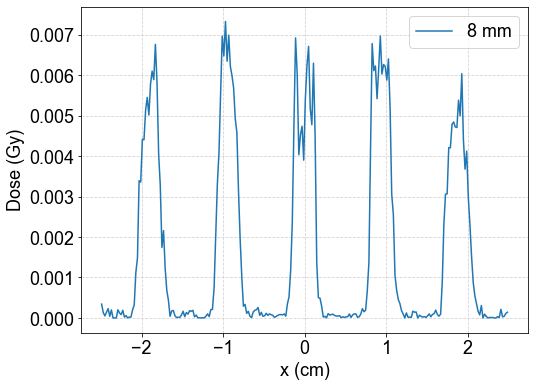

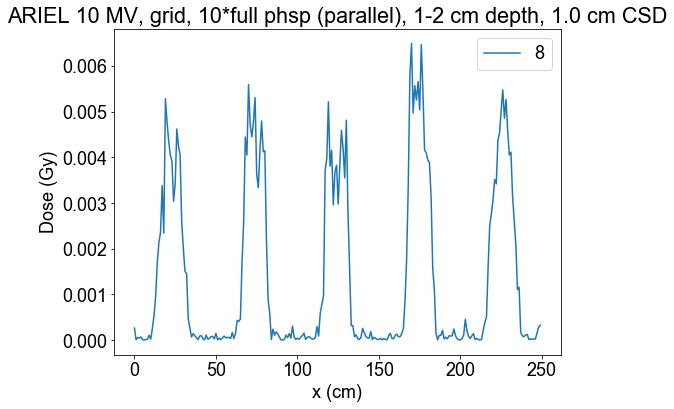

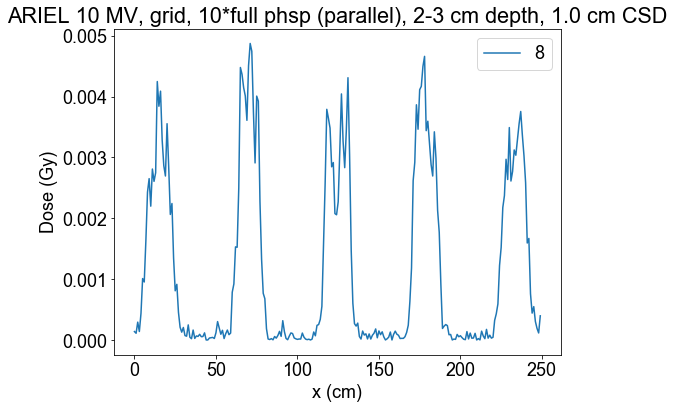

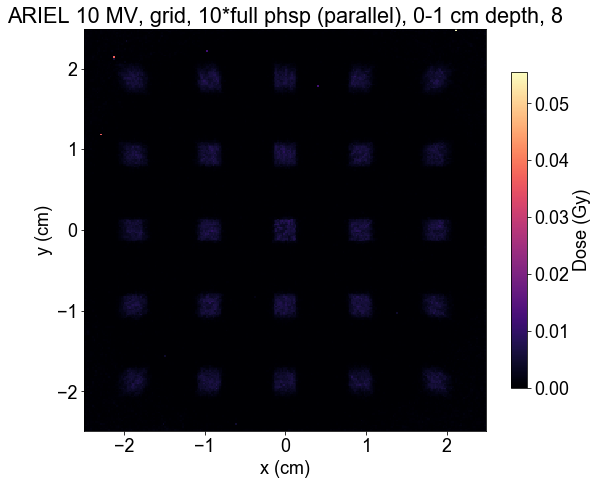

In [8]:
font = {'family' : 'Arial',
        'weight' : 'normal',
        'size'   : 18}

matplotlib.rc('font', **font)

profile1=(dose1.T[125]+dose1.T[124])/2

profile2=(dose2.T[125]+dose2.T[124])/2

profile3=(dose3.T[125]+dose3.T[124])/2

figure(1,figsize=(8,6))
#plt.title('ARIEL '+str(energy)+', '+col+', '+str(hist)+', 0-1 cm depth, '+str(CSD)+' cm CSD')
plt.plot(x,profile1,label='8 mm')
plt.legend()
plt.xlabel('x (cm)')
plt.ylabel('Dose (Gy)')
plt.grid(c='lightgray',ls='--')



figure(2,figsize=(8,6))
plt.title('ARIEL '+str(energy)+', '+col+', '+str(hist)+', 1-2 cm depth, '+str(CSD)+' cm CSD')
plt.plot(profile2,label='8')
plt.legend()
plt.xlabel('x (cm)')
plt.ylabel('Dose (Gy)')

figure(3,figsize=(8,6))
plt.title('ARIEL '+str(energy)+', '+col+', '+str(hist)+', 2-3 cm depth, '+str(CSD)+' cm CSD')
plt.plot(profile3,label='8')
plt.legend()
plt.xlabel('x (cm)')
plt.ylabel('Dose (Gy)')

figure(4,figsize=(9,8))
plt.title('ARIEL '+str(energy)+', '+col+', '+str(hist)+', 0-1 cm depth, 8')
plt.imshow(dose1,cmap='magma',extent=(-2.49,2.49,-2.49,2.49))
plt.xlabel('x (cm)')
plt.ylabel('y (cm)')
plt.colorbar(shrink=0.725,label='Dose (Gy)')




integral = 33.898664295577774
pvdr=89.72
mean peak dose rate=0.01 Gy/s


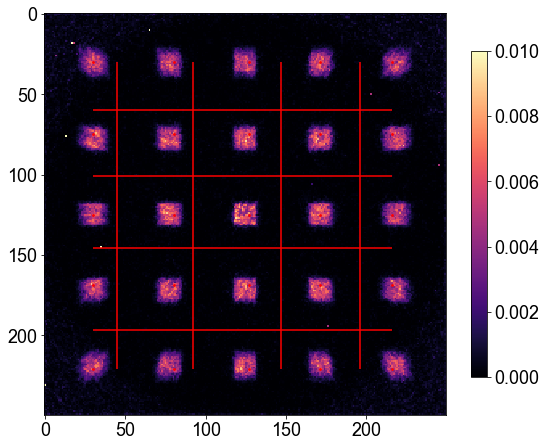

In [14]:
def align_y_axis(ax1, ax2, minresax1, minresax2,numticks):
    """ Sets tick marks of twinx axes to line up with x total tick marks

    ax1 and ax2 are matplotlib axes
    Spacing between tick marks will be a factor of minresax1 and minresax2"""

    ax1ylims = ax1.get_ybound()
    ax2ylims = ax2.get_ybound()
    ax1factor = minresax1 * (numticks-1)
    ax2factor = minresax2 * (numticks-1)
    ax1.set_yticks(np.linspace(ax1ylims[0],
                               ax1ylims[1]+(ax1factor -
                               (ax1ylims[1]-ax1ylims[0]) % ax1factor) %
                               ax1factor,
                               numticks))
    ax2.set_yticks(np.linspace(ax2ylims[0],
                               ax2ylims[1]+(ax2factor -
                               (ax2ylims[1]-ax2ylims[0]) % ax2factor) %
                               ax2factor,
                               numticks))

#integrated dose
print('integral = '+str(sum(sum(dose1))))

#dose_sum=np.array([sum(sum(dose1)),sum(sum(dose1_12)),sum(sum(dose1_22)),sum(sum(dose1_32)),sum(sum(dose1_42)),sum(sum(dose1_52))])


#peaks
mean_peaks=[]
peaks=np.zeros((6,25))
col_avgs=sum(dose1[75:175])
row_avgs=sum(dose1.T[75:175])
peak_rows=find_peaks(row_avgs,distance=30)[0]
peak_cols=find_peaks(col_avgs,distance=25)[0]
peak_cols=peak_cols[int(np.where((peak_cols>=123) & ( peak_cols <=127))[0])-2:int(np.where((peak_cols>=123) & ( peak_cols <=127))[0])+3]
peak_rows=peak_rows[int(np.where((peak_rows>=123) & ( peak_rows <=127))[0])-2:int(np.where((peak_rows>=123) & ( peak_rows <=127))[0])+3]


peaks=[dose1[j][i] for i in peak_rows for j in peak_cols]
mean_peaks=np.mean(peaks)



figure(13,figsize=(9,8))
plt.imshow(dose1.T,cmap='magma',vmax=0.01)
plt.colorbar(shrink=0.75)
for i in peak_rows:
    for j in peak_cols:
        plt.scatter(j,i,marker='o',c='red',s=3)


    
#valleys
mean_valleys=[]

col_avgs=sum(dose1[75:175])
row_avgs=sum(dose1.T[75:175])
peak_rows=find_peaks(row_avgs,distance=30)[0]
peak_cols=find_peaks(col_avgs,distance=25)[0]
peak_cols=peak_cols[int(np.where((peak_cols>=123) & ( peak_cols <=127))[0])-2:int(np.where((peak_cols>=123) & ( peak_cols <=127))[0])+3]
peak_rows=peak_rows[int(np.where((peak_rows>=123) & ( peak_rows <=127))[0])-2:int(np.where((peak_rows>=123) & ( peak_rows <=127))[0])+3]

valley_rows=find_peaks(row_avgs[peak_rows[0]:peak_rows[-1]]*-1,distance=30)[0]+peak_rows[0]
valley_cols=find_peaks(col_avgs[peak_cols[0]:peak_cols[-1]]*-1,distance=33)[0]+peak_cols[0]

vert_valleys=[]
hori_valleys=[]
    
for i in valley_cols:
    vert_valleys.append(np.mean(dose1.T[i][peak_cols[0]:peak_cols[-1]]))
for i in valley_rows:
    hori_valleys.append(np.mean(dose1[i][peak_rows[0]:peak_rows[-1]]))
              
figure(13,figsize=(9,8))
plt.hlines(valley_rows,peak_cols[0],peak_cols[-1],colors='red')
plt.vlines(valley_cols,peak_rows[0],peak_rows[-1],colors='red')

mean_valleys.append((np.mean(hori_valleys)+np.mean(vert_valleys))/2)

pvdr=mean_peaks/mean_valleys


print('pvdr='+str(round(pvdr[0],2)))
print('mean peak dose rate='+str(round(mean_peaks,2))+' Gy/s')